# Requirements

In [8]:
from IPython.display import clear_output

In [9]:
!pip install -r /kaggle/input/depth-anything-v2-code/Depth-Anything-V2-main/requirements.txt
!pip install open3d
!pip install opencv-python
!pip install opencv-contrib-python==4.6.0.66
clear_output()

# Imports

In [10]:
import sys
sys.path.append('/kaggle/input/depth-anything-v2-code/Depth-Anything-V2-main')

import cv2
import torch
import os
import pandas as pd
import numpy as np
import random
import os
import gc
import time
import open3d
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import transformers
import cv2.aruco as aruco
import torch.nn.functional as F

from torchvision import transforms
from torch.utils.data import Dataset, DataLoader
from accelerate import DistributedDataParallelKwargs, Accelerator, notebook_launcher
from accelerate.utils import set_seed
from tqdm import tqdm
from PIL import Image
from depth_anything_v2.dpt import DepthAnythingV2
from metric_depth.depth_anything_v2.dpt import DepthAnythingV2 as DepthAnythingV2Metric
from metric_depth.dataset.transform import Resize, NormalizeImage, PrepareForNet, Crop
from metric_depth.util.loss import SiLogLoss

Jupyter environment detected. Enabling Open3D WebVisualizer.
[Open3D INFO] WebRTC GUI backend enabled.
[Open3D INFO] WebRTCWindowSystem: HTTP handshake server disabled.


# Constants

In [11]:
MODELS_BASE_PATH = '/kaggle/input/depth_anything_v2/pytorch/default/1'
MODEL_TEST_DATA_BASE_PATH = '/kaggle/input/depth-anything-v2-code/Depth-Anything-V2-main/assets/examples'
FISHEYE_DATA_BASE_PATH = '/kaggle/input/fisheye-data/mini'
DEVICE = 'cuda' if torch.cuda.is_available() else 'cpu'

In [12]:
len(os.listdir(FISHEYE_DATA_BASE_PATH))

149

# Inference

In [13]:
def seed_everything(seed: int = 42) -> None:
    # no cuda reproducibility
    os.environ['PYTHONHASHSEED'] = str(seed)
    np.random.seed(seed)
    random.seed(seed)
    torch.manual_seed(seed)
    set_seed(seed)

seed_everything()

In [14]:
def clear() -> None:
    torch.cuda.empty_cache()
    gc.collect()

In [15]:
model_configs = {
    'small': {'encoder': 'vits', 'features': 64, 'out_channels': [48, 96, 192, 384]},
    'base': {'encoder': 'vitb', 'features': 128, 'out_channels': [96, 192, 384, 768]},
    'large': {'encoder': 'vitl', 'features': 256, 'out_channels': [256, 512, 1024, 1024]}
}

In [16]:
def infer_and_show(models: list[DepthAnythingV2], 
                   image_titles: list[str], 
                   image_path: str,
                   model_type: str) -> None:
    img = cv2.imread(image_path)
    fig, ax = plt.subplots(1, len(image_titles) + 1, figsize=(16, 8))
    ax[0].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    ax[0].set_axis_off()
    cmap = 'Spectral_r' if model_type == 'relative' else 'Spectral'
    for ind, model in enumerate(models, start=1):
        model.eval()
        depth = model.infer_image(img)
        if model_type == 'relative':
            colormap_title = 'Относительная глубина'
            depth = (depth - depth.min()) / (depth.max() - depth.min()) * 255.0
            depth = depth.astype(np.uint8)
        else:
            colormap_title = 'Предсказанная глубина (м)'
        img_ax = ax[ind].imshow(depth, cmap=cmap)
        ax[ind].set_title(image_titles[ind - 1])
        ax[ind].set_axis_off()
    fig.colorbar(
        img_ax, ax=ax, label=colormap_title, 
        orientation='vertical', fraction=0.01,
        cmap=cmap
    )
    plt.show()


## Relative depth

In [17]:
models_pretrained = []
image_titles = []
pretrained_models_pathes = [
    os.path.join(MODELS_BASE_PATH, 'depth_anything_v2_vits_small.pth'),
    os.path.join(MODELS_BASE_PATH, 'depth_anything_v2_vitb_base.pth'),
    os.path.join(MODELS_BASE_PATH, 'depth_anything_v2_vitl_large.pth')
]
for model_path in pretrained_models_pathes:
    model_type = model_path.split('_')[-1].split('.')[0]
    image_titles.append(model_type)
    config = model_configs[model_type]
    model = DepthAnythingV2(**config)
    model.load_state_dict(torch.load(model_path))
    model = model.to(DEVICE)
    models_pretrained.append(model)

/tmp/ipykernel_31/3083234563.py:13: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path))


### Depth anything test data

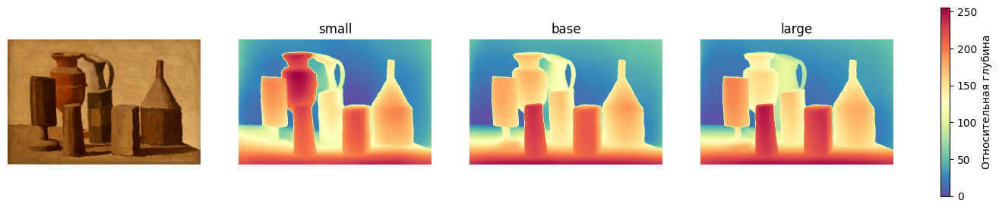

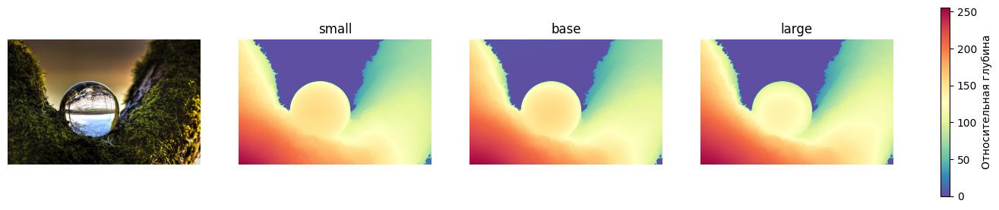

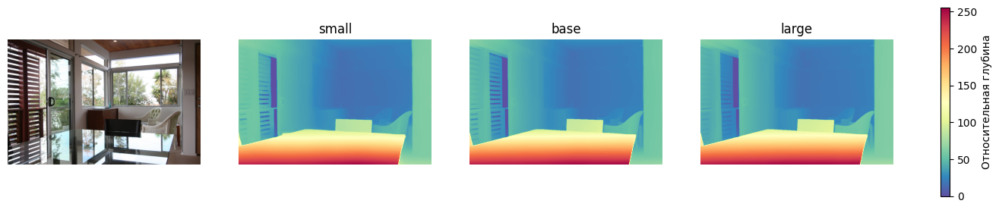

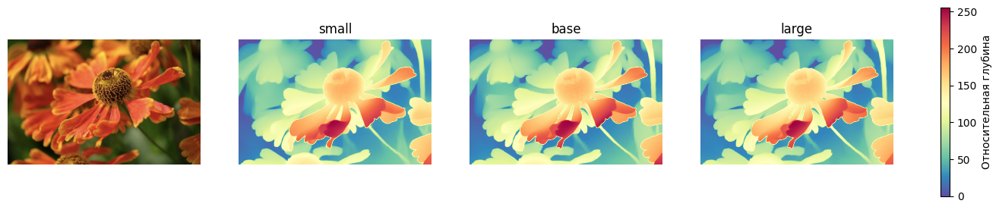

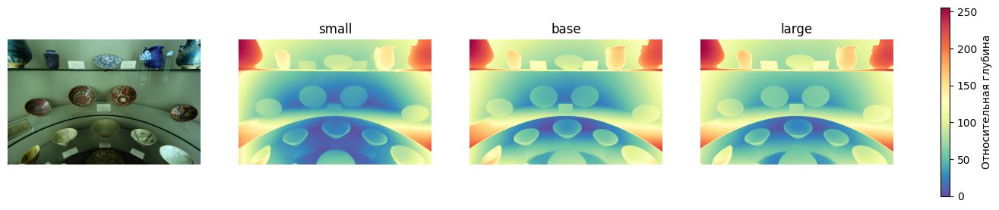

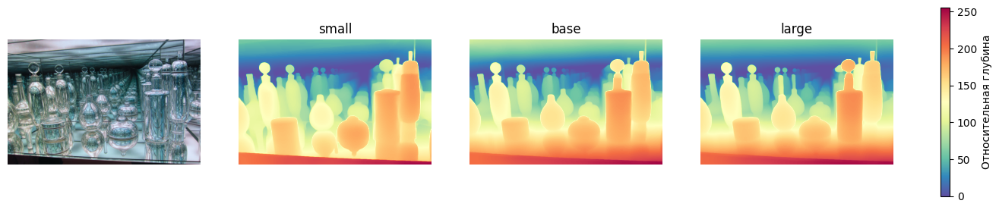

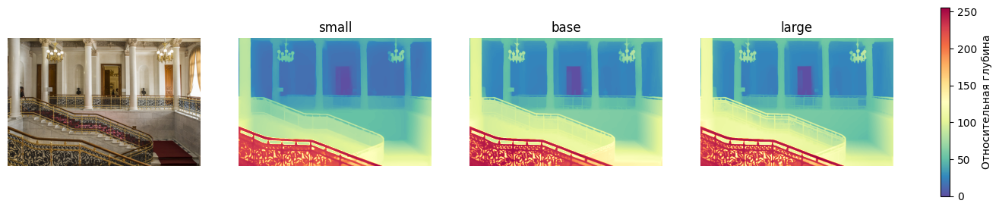

In [18]:
# чем больше относительная глубина, тем ближе находится объект
test_images_pathes = [
    os.path.join(MODEL_TEST_DATA_BASE_PATH, 'demo03.jpg'),
    os.path.join(MODEL_TEST_DATA_BASE_PATH, 'demo04.jpg'),
    os.path.join(MODEL_TEST_DATA_BASE_PATH, 'demo10.jpg'),
    os.path.join(MODEL_TEST_DATA_BASE_PATH, 'demo12.jpg'),
    os.path.join(MODEL_TEST_DATA_BASE_PATH, 'demo13.jpg'),
    os.path.join(MODEL_TEST_DATA_BASE_PATH, 'demo14.jpg'),
    os.path.join(MODEL_TEST_DATA_BASE_PATH, 'demo15.jpg')
]
for image_path in test_images_pathes:
    infer_and_show(
        models_pretrained, 
        image_titles,
        image_path,
        'relative'
    )

### Fisheye data

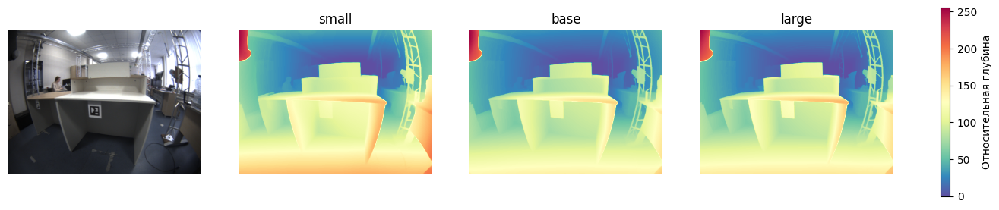

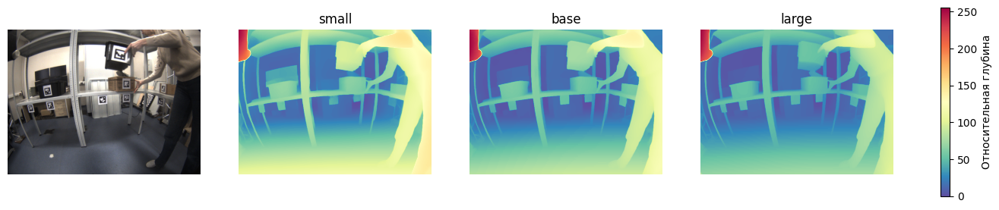

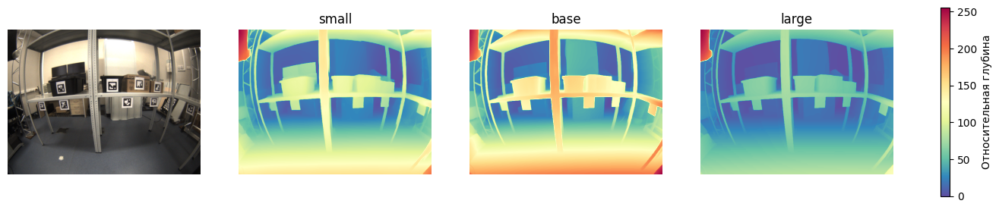

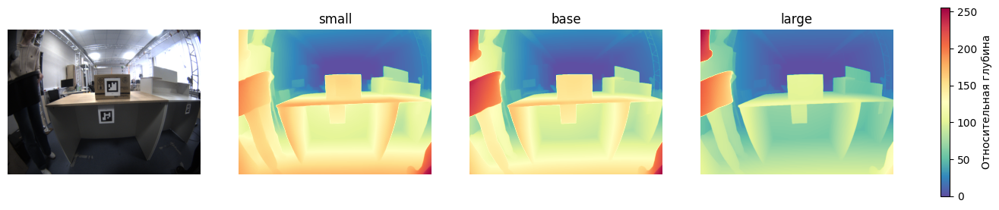

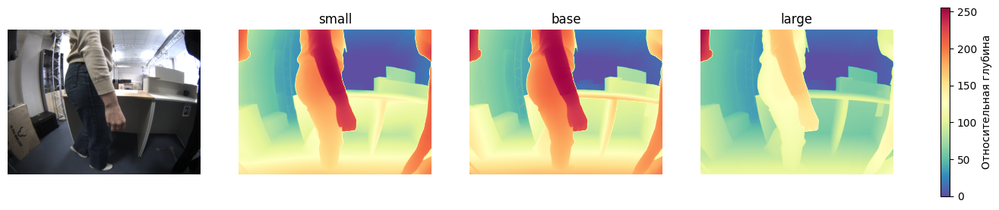

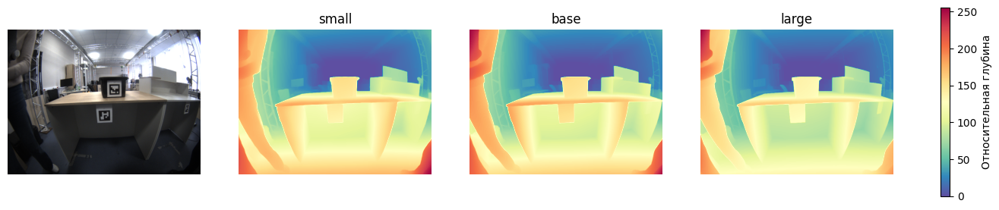

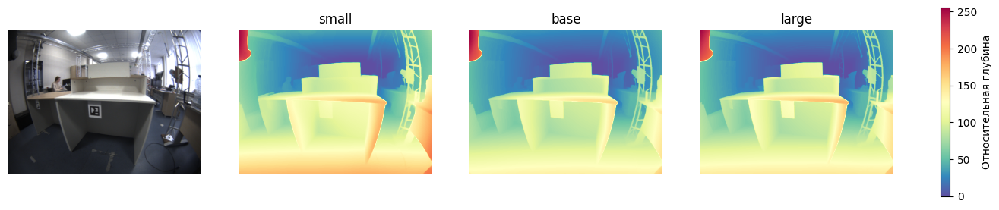

In [19]:
# чем больше относительная глубина, тем ближе находится объект
data_pathes = [
    os.path.join(FISHEYE_DATA_BASE_PATH, path) for path in os.listdir(FISHEYE_DATA_BASE_PATH)
]
num_images = 7
fisheye_images_pathes = np.random.choice(data_pathes, num_images)
for image_path in fisheye_images_pathes:
    infer_and_show(
        models_pretrained,
        image_titles,
        image_path,
        'relative'
    )

## Metric depth

In [20]:
models_metric = []
image_titles = []
metric_models_pathes = [
    os.path.join(MODELS_BASE_PATH, 'depth_anything_v2_metric_hypersim_vits_small.pth'),
    os.path.join(MODELS_BASE_PATH, 'depth_anything_v2_metric_hypersim_vitb_base.pth'),
    os.path.join(MODELS_BASE_PATH, 'depth_anything_v2_metric_hypersim_vitl_large.pth')
]
for model_path in metric_models_pathes:
    model_type = model_path.split('_')[-1].split('.')[0]
    image_titles.append(model_type)
    config = model_configs[model_type]
    model = DepthAnythingV2Metric(**config, max_depth=20.0)
    model.load_state_dict(torch.load(model_path))
    model = model.to(DEVICE)
    models_metric.append(model)

/tmp/ipykernel_31/1686014710.py:13: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path))


### Depth anything test data

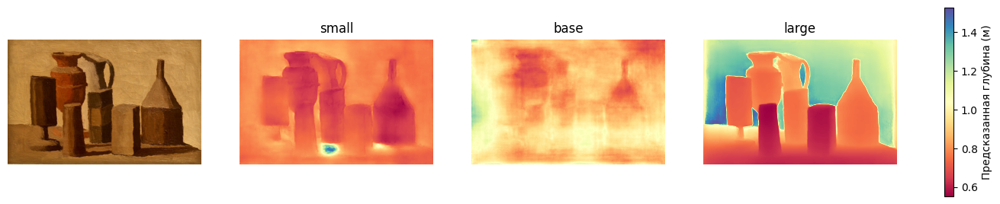

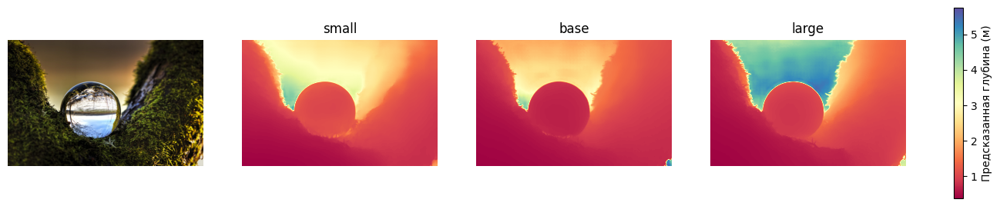

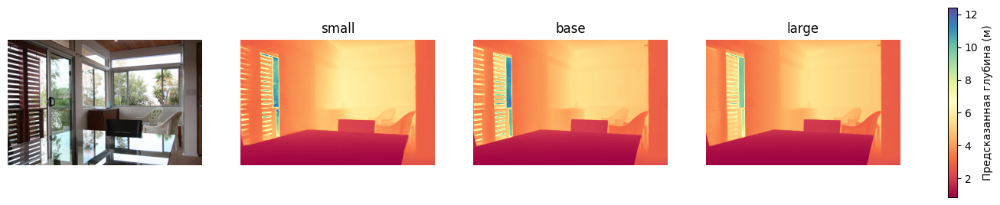

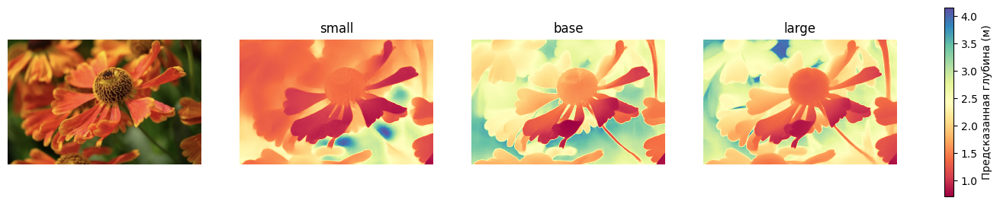

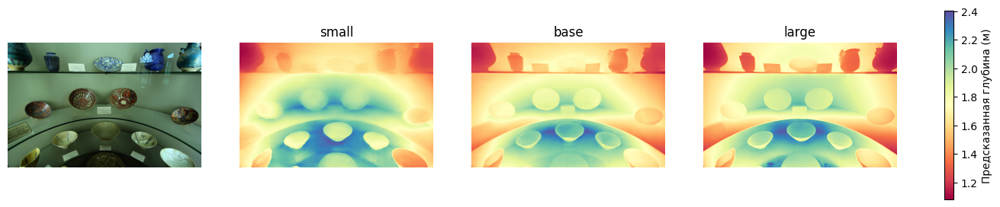

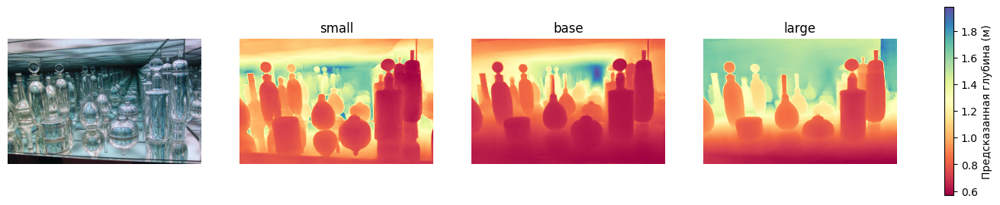

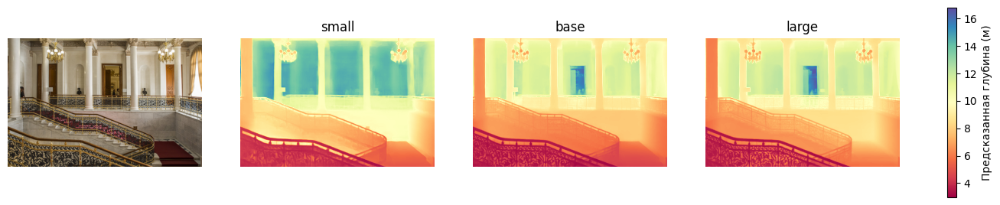

In [21]:
for image_path in test_images_pathes:
    infer_and_show(
        models_metric, 
        image_titles,
        image_path,
        'metric'
    )

### Fisheye data

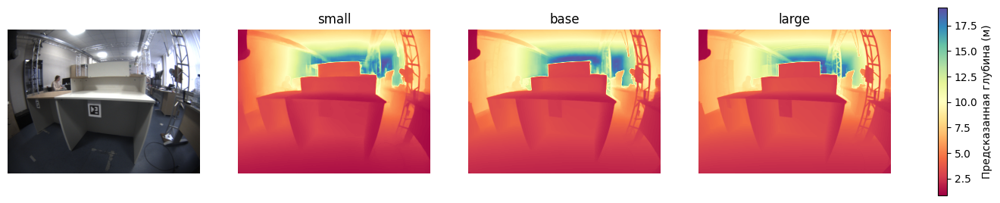

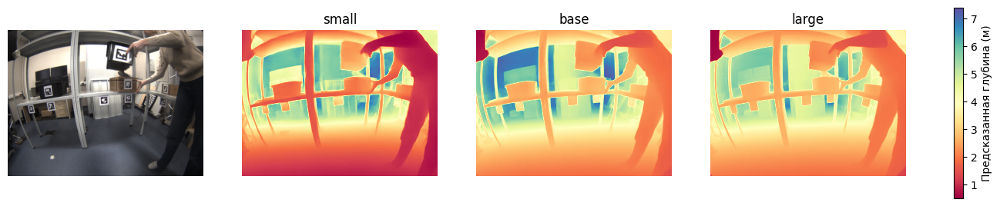

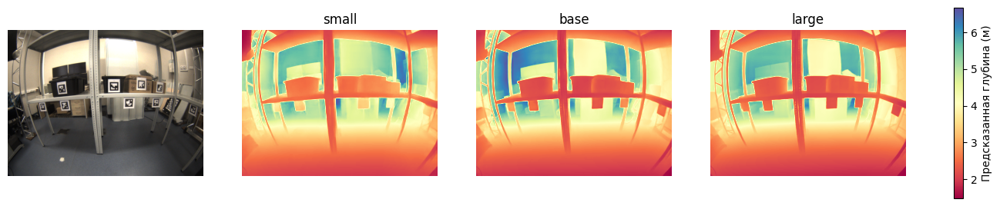

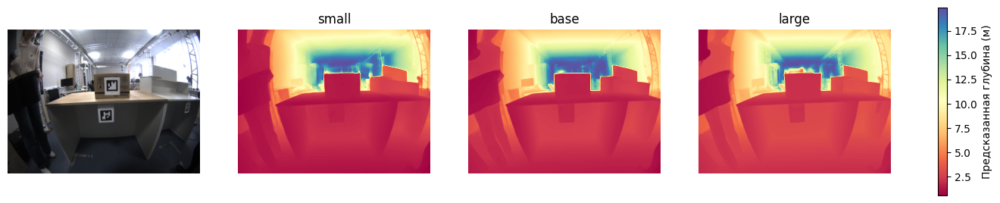

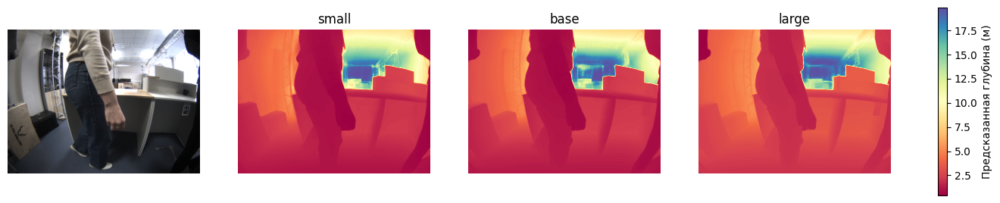

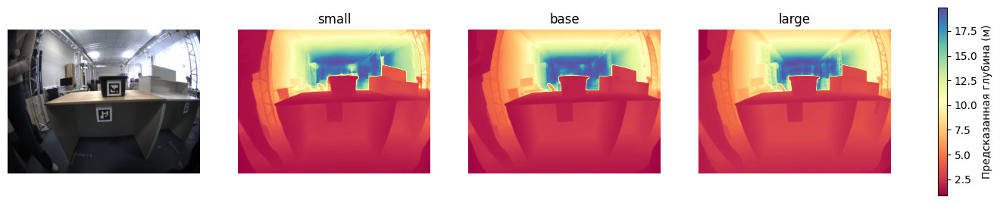

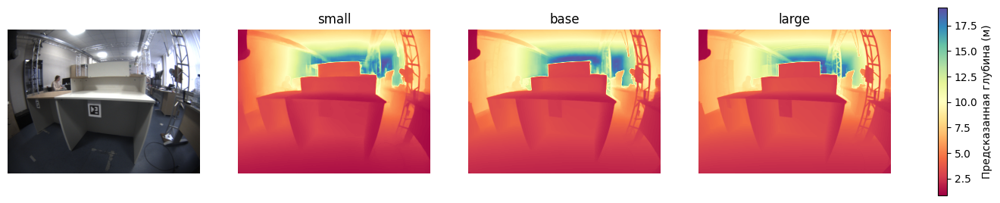

In [22]:
for image_path in fisheye_images_pathes:
    infer_and_show(
        models_metric,
        image_titles,
        image_path,
        'mertic'
    )

## Inference time and memory consumption

In [23]:
# для чистоты эксперимента ядро было перезапущено несколько раз на каждой модели
test_image = cv2.imread(os.path.join(FISHEYE_DATA_BASE_PATH, '1728630164647873039.png'))

model = DepthAnythingV2Metric(**model_configs['large'], max_depth=20.0)
model.load_state_dict(torch.load(
    os.path.join(MODELS_BASE_PATH, 'depth_anything_v2_metric_hypersim_vitl_large.pth')
))
model = model.to(DEVICE)
torch.cuda.reset_peak_memory_stats()

peak_before = torch.cuda.max_memory_allocated()
start_time = time.time()
output = model.infer_image(test_image)
peak_after = torch.cuda.max_memory_allocated()
end_time = time.time()
inference_time = end_time - start_time  # seconds
peak_diff = (peak_after - peak_before) / (1024 ** 2)  # MB
print(inference_time, peak_diff, sep='\n')

/tmp/ipykernel_31/3592285245.py:5: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(


0.6899175643920898
503.6767578125


0.3428051471710205
188.999023437

0.5033981800079346
362.322265625

0.7731044292449951
511.39306640625

# Point cloud

In [24]:
model = DepthAnythingV2Metric(**model_configs['large'], max_depth=20.0)
model.load_state_dict(torch.load(
    os.path.join(MODELS_BASE_PATH, 'depth_anything_v2_metric_hypersim_vitl_large.pth')
))
model = model.to(DEVICE)

/tmp/ipykernel_31/2217975756.py:2: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(


In [25]:
def get_point_cloud(model: DepthAnythingV2Metric,
                    image_path: str, 
                    fx: float, fy: float, 
                    cx: float, cy: float) -> open3d.geometry.PointCloud:
    img = cv2.imread(image_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    color_image = Image.open(image_path).convert('RGB')
    width, height = color_image.size
    z = Image.fromarray(model.infer_image(img)).resize((width, height), Image.NEAREST)
    z = -np.array(z)  # minus because depth is inverted in open3d (more depth means object is further)
    # calculating points coordinates
    x, y = np.meshgrid(np.arange(width), np.arange(height))
    x = (x - cx) / fx
    y = (y - cy) / fy
    points = np.stack((np.multiply(x, z), np.multiply(y, z), z), axis=-1).reshape(-1, 3)
    colors = np.array(color_image).reshape(-1, 3) / 255.0

    pcd = open3d.geometry.PointCloud()
    pcd.points = open3d.utility.Vector3dVector(points)
    pcd.colors = open3d.utility.Vector3dVector(colors)
    
    # saving
    open3d.io.write_point_cloud(f"{image_path.split('/')[-1].split('.')[0]}_pcd.ply", pcd)
        
    return pcd

In [26]:
get_point_cloud(
    model,
    os.path.join(FISHEYE_DATA_BASE_PATH, '1728630198323521417.png'), 
    fx=580.77518, fy=580.77518, cx=724.75002, cy=570.98956
)

PointCloud with 1555200 points.

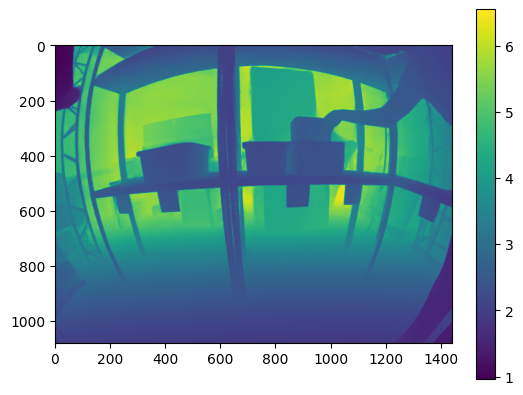

In [27]:
plt.imshow(model.infer_image(cv2.imread(os.path.join(FISHEYE_DATA_BASE_PATH, '1728630198323521417.png'))))
plt.colorbar()

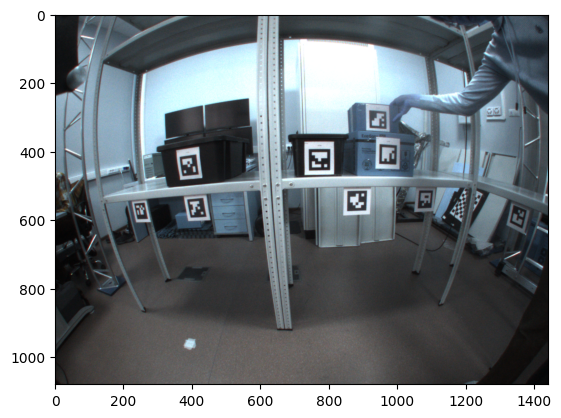

In [28]:
plt.imshow(cv2.imread(os.path.join(FISHEYE_DATA_BASE_PATH, '1728630198323521417.png')))

# Depth maps for fisheye images

In [29]:
model = DepthAnythingV2Metric(**model_configs['large'], max_depth=20.0)
model.load_state_dict(torch.load(
    os.path.join(MODELS_BASE_PATH, 'depth_anything_v2_metric_hypersim_vitl_large.pth')
))
model = model.to(DEVICE)

/tmp/ipykernel_31/2217975756.py:2: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(


In [30]:
aruco_dict = aruco.Dictionary_get(aruco.DICT_5X5_250)
parameters = aruco.DetectorParameters_create()
camera_matrix = np.array([
    [580.77518, 0.0, 724.75002],
    [0.0, 580.77518, 570.98956],
    [0.0, 0.0, 1.0]
])
distortion_coeffs = np.array([
    [0.927077],
    [0.141438],
    [0.000196],
    [0.001695],
    [-8.7e-05],
    [1.257216],
    [0.354688],
    [0.015954]
])

def create_depth_map(model: DepthAnythingV2Metric, 
                     img_path: str, 
                     save_dir: str = None) -> np.ndarray:
    img = cv2.imread(img_path)
    img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    # model inference
    depth = model.infer_image(img)
    # getting distance from camera to aruco markers
    corners, ids, rej = aruco.detectMarkers(
        img_gray, aruco_dict, parameters=parameters
    )
    rvec, tvec, _ = aruco.estimatePoseSingleMarkers(
        corners, 0.08, camera_matrix, distortion_coeffs[:4]
    )
    ratio = 0
    for ind, cur_tvec in enumerate(tvec):
        z = cur_tvec[0][2]  # getting z coordinate
        corner = corners[ind][0]
        tl, br = corner[0], corner[2]
        center = (int((tl[1] + br[1]) / 2), int((tl[0] + br[0]) / 2))
        ratio += z / depth[center[0]][center[1]]
    
    ratio = ratio / len(corners)
    depth = ratio * depth
    
    if save_dir:
        if not os.path.isdir(save_dir):
            os.mkdir(save_dir)
        save_subdir = img_path.split('/')[-1].split('.')[0]
        os.mkdir(os.path.join(save_dir, save_subdir))
        cv2.imwrite(os.path.join(save_dir, save_subdir, 'real_img.png'), img)
        np.save(os.path.join(save_dir, save_subdir, 'depth_map.npy'), depth)
    
    return depth

In [31]:
for img_ind in tqdm(os.listdir(FISHEYE_DATA_BASE_PATH)):
    create_depth_map(
        model,
        os.path.join(FISHEYE_DATA_BASE_PATH, img_ind),
        'fisheye_w_depth_maps'
    )

!zip -r fisheye_w_depth_maps.zip fisheye_w_depth_maps
clear_output()

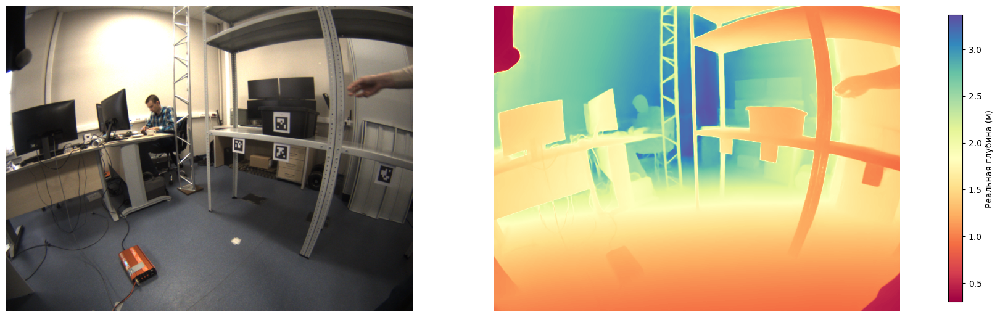

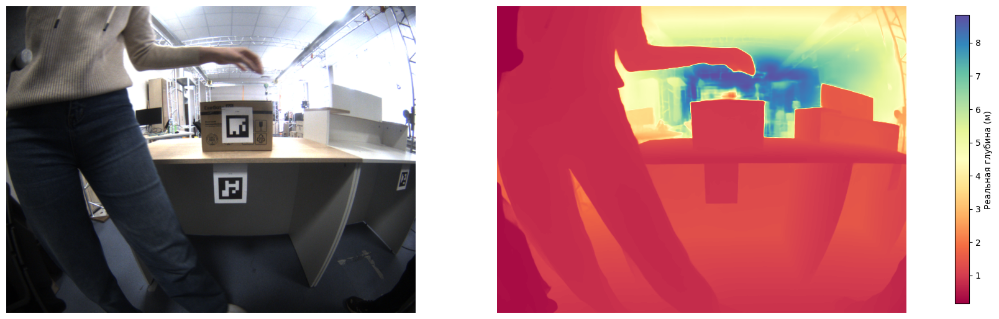

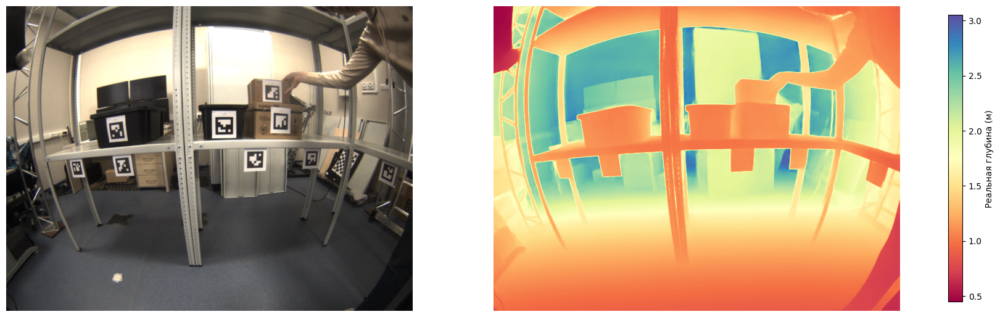

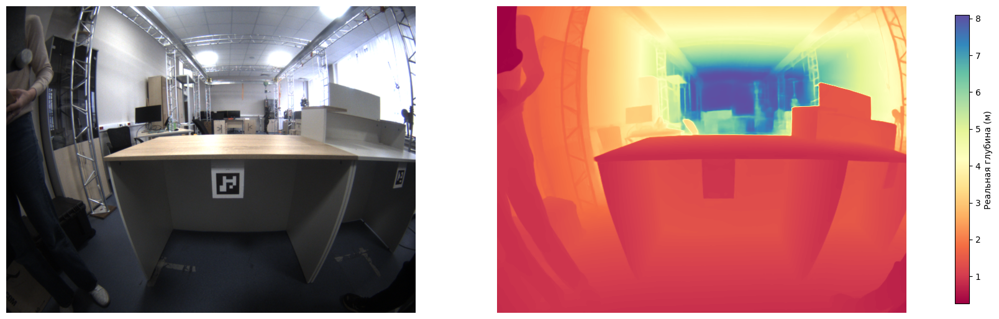

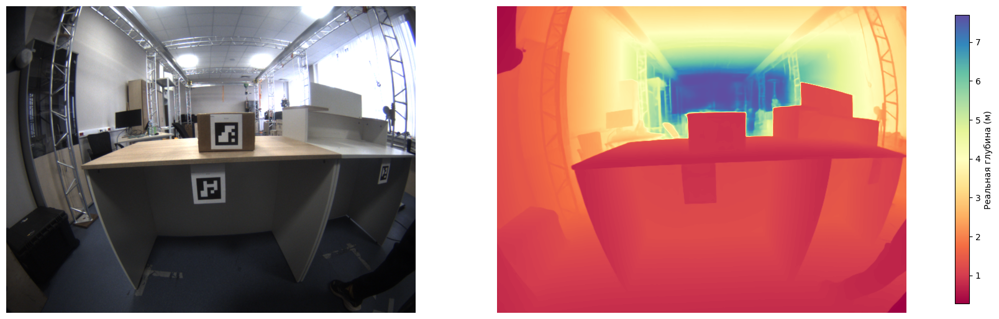

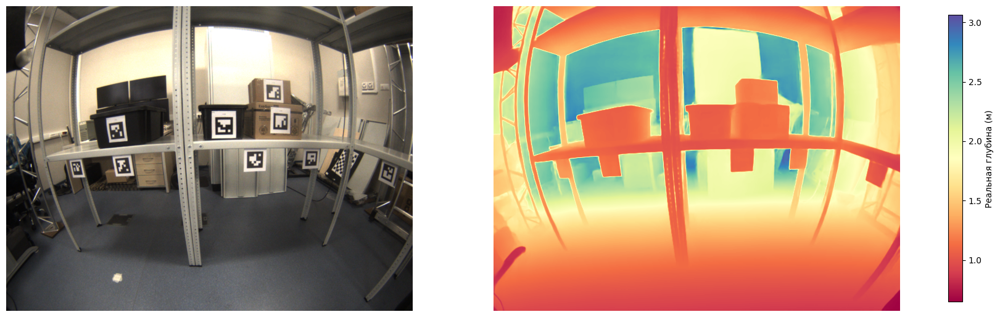

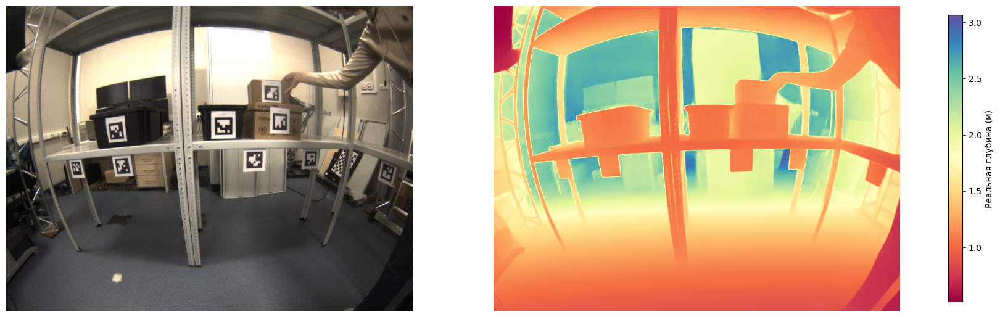

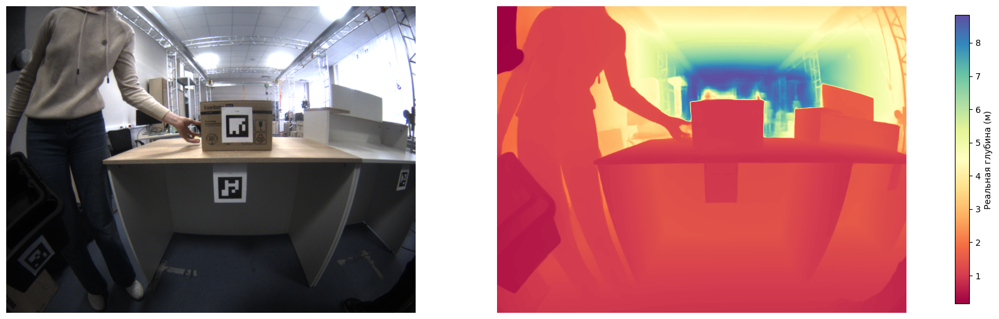

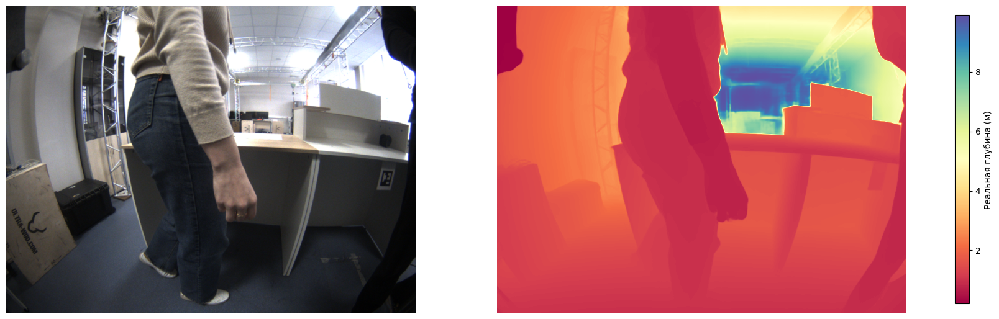

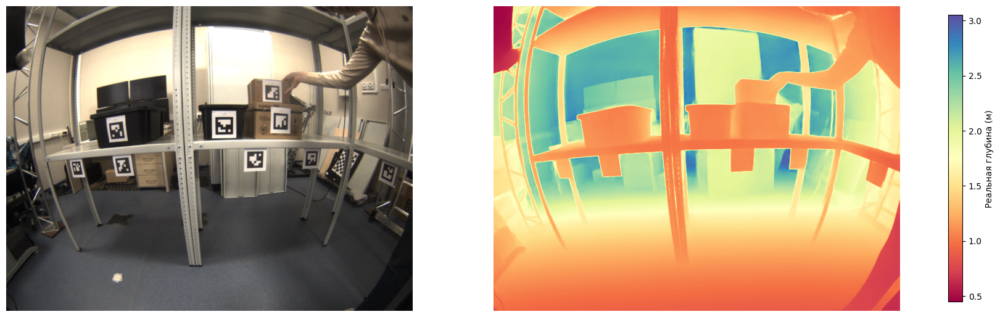

In [32]:
data_dir = '/kaggle/input/fisheye-data-w-depth-maps/fisheye_w_depth_maps'
for subdir in np.random.choice(os.listdir(data_dir), 10):
    fig, ax = plt.subplots(1, 2, figsize=(20, 10))
    img = cv2.imread(os.path.join(data_dir, subdir, 'real_img.png'))
    depth = np.load(os.path.join(data_dir, subdir, 'depth_map.npy'))
    ax[0].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    ax[0].set_axis_off()
    cmap = 'Spectral'
    img_ax = ax[1].imshow(depth, cmap=cmap)
    ax[1].set_axis_off()
    fig.colorbar(
        img_ax, ax=ax, label='Реальная глубина (м)', 
        orientation='vertical', fraction=0.015,
        cmap=cmap
    )
    plt.show()

# Fine tunning

## Dataset and DataLoader

In [33]:
class DepthMapDataset(Dataset):
    def __init__(self, paths: list[str], mode: str, size: tuple[int, int] = (518, 518)):
        self.mode = mode
        self.paths = paths
        self.transform = transforms.Compose([
            Resize(
                width=size[0],
                height=size[0],
                resize_target=True,
                keep_aspect_ratio=True,
                ensure_multiple_of=14,
                resize_method='lower_bound',
                image_interpolation_method=cv2.INTER_CUBIC,
            ),
            NormalizeImage(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
            PrepareForNet(),
        ] + ([Crop(size[0])] if mode == 'train' else []))
    
    def __getitem__(self, item: int) -> dict[str, torch.Tensor]:
        img_path = os.path.join(self.paths[item], 'real_img.png')
        depth_path = os.path.join(self.paths[item], 'depth_map.npy')
        
        img = cv2.imread(img_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB) / 255.0
        depth = np.load(depth_path)
        
        sample = self.transform({'image': img, 'depth': depth})
        sample['image'] = torch.from_numpy(sample['image'])
        sample['depth'] = torch.from_numpy(sample['depth'])
        
        return sample
        
    def __len__(self) -> int:
        return len(self.paths)

In [34]:
data_path = '/kaggle/input/fisheye-data-w-depth-maps/fisheye_w_depth_maps'
paths = [
    os.path.join(data_path, path) for path in os.listdir(data_path)
]
train_size = 0.75
train_paths = np.random.choice(paths, int(len(paths) * train_size), replace=False)
val_paths = list(set(paths) - set(train_paths))
train_dataset = DepthMapDataset(train_paths, 'train')
val_dataset = DepthMapDataset(val_paths, 'val')
train_dataloader = DataLoader(train_dataset, batch_size=4, shuffle=True, num_workers=4, drop_last=True)
val_dataloader = DataLoader(val_dataset, batch_size=1, shuffle=False, num_workers=4, drop_last=True)

## Training

In [35]:
model = DepthAnythingV2Metric(**model_configs['small'], max_depth=20.0)

model_path = os.path.join(MODELS_BASE_PATH, 'depth_anything_v2_metric_hypersim_vits_small.pth')
# only encoder pretrained weights
model.load_state_dict(
    {k: v for k, v in torch.load(model_path).items() if 'pretrained' in k}, 
    strict=False
)
model = model.to(DEVICE)

/tmp/ipykernel_31/2744864604.py:6: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  {k: v for k, v in torch.load(model_path).items() if 'pretrained' in k},


In [36]:
lr = 5e-6
weight_decay = 0.01

optimizer = torch.optim.AdamW(
    [
        {'params': [param for name, param in model.named_parameters() if 'pretrained' in name], 'lr': lr},
        {'params': [param for name, param in model.named_parameters() if 'pretrained' not in name], 'lr': lr * 10}
    ],
    lr=lr, 
    weight_decay=weight_decay
)
criterion = SiLogLoss()

In [37]:
def train():
    min_loss = 1e12
    num_epochs = 100
    if not os.path.isdir('checkpoints'):
        os.mkdir('checkpoints')
    for epoch in range(num_epochs):
        clear()
        # training step
        model.train()
        train_loss = 0
        for sample in tqdm(train_dataloader):
            optimizer.zero_grad()
            img, depth = sample['image'].to(DEVICE), sample['depth'].to(DEVICE)
            pred = model(img) 
            loss = criterion(pred, depth, (depth >= 0.001) & (depth <= 20.0))
            
            loss.backward()
            optimizer.step()
            
            train_loss += loss.detach()
            
        train_loss /= len(train_dataloader)
        
        # evaluation
        model.eval()
        val_loss = 0
        val_mae = 0
        for sample in tqdm(val_dataloader):
            img, depth = sample['image'].to(DEVICE), sample['depth'].to(DEVICE)
            
            with torch.no_grad():
                pred = model(img)
            
            val_loss += criterion(pred, depth, (depth >= 0.001) & (depth <= 20.0)).detach()
            
        val_loss /= len(val_dataloader)
        
        if val_loss < min_loss:
            min_loss = val_loss
            torch.save(model.state_dict(), f'checkpoints/model_cp_{epoch}.pth')
            
        print(
            f'Epoch: {epoch} | train loss: {train_loss} | val loss : {val_loss}'
        )

In [38]:
train()

100%|██████████| 38/38 [00:03<00:00, 10.07it/s]


Epoch: 0 | train loss: 0.913615345954895 | val loss : 0.4574088156223297


100%|██████████| 38/38 [00:03<00:00,  9.91it/s]


Epoch: 1 | train loss: 0.44570139050483704 | val loss : 0.34211301803588867


100%|██████████| 38/38 [00:03<00:00, 10.10it/s]


Epoch: 2 | train loss: 0.3632704019546509 | val loss : 0.29951193928718567


100%|██████████| 38/38 [00:03<00:00,  9.74it/s]


Epoch: 3 | train loss: 0.3100091516971588 | val loss : 0.26356959342956543


100%|██████████| 38/38 [00:03<00:00, 10.02it/s]


Epoch: 4 | train loss: 0.3008054494857788 | val loss : 0.3462259769439697


100%|██████████| 38/38 [00:03<00:00, 10.03it/s]


Epoch: 5 | train loss: 0.2857458293437958 | val loss : 0.23821629583835602


100%|██████████| 38/38 [00:03<00:00, 10.10it/s]


Epoch: 6 | train loss: 0.25610649585723877 | val loss : 0.23345062136650085


100%|██████████| 38/38 [00:03<00:00, 10.14it/s]


Epoch: 7 | train loss: 0.2466982752084732 | val loss : 0.21607212722301483


100%|██████████| 38/38 [00:03<00:00, 10.10it/s]


Epoch: 8 | train loss: 0.2400372326374054 | val loss : 0.2064998298883438


100%|██████████| 38/38 [00:03<00:00,  9.99it/s]


Epoch: 9 | train loss: 0.24501962959766388 | val loss : 0.2027929276227951


100%|██████████| 38/38 [00:03<00:00, 10.00it/s]


Epoch: 10 | train loss: 0.2463330775499344 | val loss : 0.22810956835746765


100%|██████████| 38/38 [00:03<00:00, 10.10it/s]


Epoch: 11 | train loss: 0.22045287489891052 | val loss : 0.21276381611824036


100%|██████████| 38/38 [00:03<00:00, 10.06it/s]


Epoch: 12 | train loss: 0.20500722527503967 | val loss : 0.20942361652851105


100%|██████████| 38/38 [00:03<00:00, 10.09it/s]


Epoch: 13 | train loss: 0.20528627932071686 | val loss : 0.22679786384105682


100%|██████████| 38/38 [00:03<00:00, 10.08it/s]


Epoch: 14 | train loss: 0.21335378289222717 | val loss : 0.19325003027915955


100%|██████████| 38/38 [00:03<00:00, 10.09it/s]


Epoch: 15 | train loss: 0.18004058301448822 | val loss : 0.1849798560142517


100%|██████████| 38/38 [00:03<00:00,  9.92it/s]


Epoch: 16 | train loss: 0.1743558645248413 | val loss : 0.17726363241672516


100%|██████████| 38/38 [00:03<00:00, 10.04it/s]


Epoch: 17 | train loss: 0.19039955735206604 | val loss : 0.17443543672561646


100%|██████████| 38/38 [00:03<00:00, 10.07it/s]


Epoch: 18 | train loss: 0.1892763376235962 | val loss : 0.2022368162870407


100%|██████████| 38/38 [00:03<00:00,  9.99it/s]


Epoch: 19 | train loss: 0.19894200563430786 | val loss : 0.18567921221256256


100%|██████████| 38/38 [00:03<00:00, 10.03it/s]


Epoch: 20 | train loss: 0.16716216504573822 | val loss : 0.18350647389888763


100%|██████████| 38/38 [00:03<00:00, 10.03it/s]


Epoch: 21 | train loss: 0.17339646816253662 | val loss : 0.172084242105484


100%|██████████| 38/38 [00:03<00:00,  9.98it/s]


Epoch: 22 | train loss: 0.15295858681201935 | val loss : 0.1766635924577713


100%|██████████| 38/38 [00:03<00:00, 10.11it/s]


Epoch: 23 | train loss: 0.14536088705062866 | val loss : 0.1625819057226181


100%|██████████| 38/38 [00:03<00:00,  9.97it/s]


Epoch: 24 | train loss: 0.1441686451435089 | val loss : 0.1727743148803711


100%|██████████| 38/38 [00:03<00:00,  9.78it/s]


Epoch: 25 | train loss: 0.12668724358081818 | val loss : 0.15383683145046234


100%|██████████| 38/38 [00:03<00:00,  9.98it/s]


Epoch: 26 | train loss: 0.13049671053886414 | val loss : 0.1665688008069992


100%|██████████| 38/38 [00:03<00:00, 10.06it/s]


Epoch: 27 | train loss: 0.1269719898700714 | val loss : 0.1573348194360733


100%|██████████| 38/38 [00:03<00:00, 10.05it/s]


Epoch: 28 | train loss: 0.14065535366535187 | val loss : 0.14982816576957703


100%|██████████| 38/38 [00:03<00:00, 10.07it/s]


Epoch: 29 | train loss: 0.11870621889829636 | val loss : 0.15402552485466003


100%|██████████| 38/38 [00:03<00:00, 10.04it/s]


Epoch: 30 | train loss: 0.12269598245620728 | val loss : 0.15556657314300537


100%|██████████| 38/38 [00:03<00:00, 10.13it/s]


Epoch: 31 | train loss: 0.12173562496900558 | val loss : 0.14635097980499268


100%|██████████| 38/38 [00:03<00:00, 10.09it/s]


Epoch: 32 | train loss: 0.1187431812286377 | val loss : 0.15134885907173157


100%|██████████| 38/38 [00:03<00:00, 10.11it/s]


Epoch: 33 | train loss: 0.12346060574054718 | val loss : 0.14849504828453064


100%|██████████| 38/38 [00:03<00:00, 10.16it/s]


Epoch: 34 | train loss: 0.12326420843601227 | val loss : 0.1491251438856125


100%|██████████| 38/38 [00:03<00:00, 10.11it/s]


Epoch: 35 | train loss: 0.11673462390899658 | val loss : 0.14456546306610107


100%|██████████| 38/38 [00:03<00:00, 10.05it/s]


Epoch: 36 | train loss: 0.11493244022130966 | val loss : 0.13801009953022003


100%|██████████| 38/38 [00:03<00:00,  9.99it/s]


Epoch: 37 | train loss: 0.11336982995271683 | val loss : 0.14196527004241943


100%|██████████| 38/38 [00:03<00:00, 10.08it/s]


Epoch: 38 | train loss: 0.11405049264431 | val loss : 0.13965348899364471


100%|██████████| 38/38 [00:03<00:00, 10.10it/s]


Epoch: 39 | train loss: 0.11055611819028854 | val loss : 0.13836300373077393


100%|██████████| 38/38 [00:03<00:00, 10.13it/s]


Epoch: 40 | train loss: 0.10979598015546799 | val loss : 0.13732944428920746


100%|██████████| 38/38 [00:03<00:00,  9.94it/s]


Epoch: 41 | train loss: 0.11096729338169098 | val loss : 0.13930873572826385


100%|██████████| 38/38 [00:03<00:00, 10.13it/s]


Epoch: 42 | train loss: 0.1105407327413559 | val loss : 0.13881295919418335


100%|██████████| 38/38 [00:03<00:00, 10.09it/s]


Epoch: 43 | train loss: 0.11022890359163284 | val loss : 0.15146447718143463


100%|██████████| 38/38 [00:03<00:00,  9.95it/s]


Epoch: 44 | train loss: 0.11687580496072769 | val loss : 0.13597948849201202


100%|██████████| 38/38 [00:03<00:00, 10.11it/s]


Epoch: 45 | train loss: 0.11189165711402893 | val loss : 0.15187588334083557


100%|██████████| 38/38 [00:03<00:00, 10.03it/s]


Epoch: 46 | train loss: 0.11908138543367386 | val loss : 0.15365639328956604


100%|██████████| 38/38 [00:03<00:00,  9.74it/s]


Epoch: 47 | train loss: 0.12164907157421112 | val loss : 0.1369073987007141


100%|██████████| 38/38 [00:03<00:00, 10.01it/s]


Epoch: 48 | train loss: 0.11304854601621628 | val loss : 0.14227290451526642


100%|██████████| 38/38 [00:03<00:00, 10.02it/s]


Epoch: 49 | train loss: 0.1168060228228569 | val loss : 0.13601753115653992


100%|██████████| 38/38 [00:03<00:00, 10.08it/s]


Epoch: 50 | train loss: 0.1151244193315506 | val loss : 0.1496509164571762


100%|██████████| 38/38 [00:03<00:00, 10.02it/s]


Epoch: 51 | train loss: 0.11702775210142136 | val loss : 0.13348369300365448


100%|██████████| 38/38 [00:03<00:00, 10.15it/s]


Epoch: 52 | train loss: 0.10398020595312119 | val loss : 0.13058698177337646


100%|██████████| 38/38 [00:03<00:00, 10.11it/s]


Epoch: 53 | train loss: 0.10137191414833069 | val loss : 0.1305169314146042


100%|██████████| 38/38 [00:03<00:00, 10.10it/s]


Epoch: 54 | train loss: 0.10180414468050003 | val loss : 0.14186863601207733


100%|██████████| 38/38 [00:03<00:00, 10.10it/s]


Epoch: 55 | train loss: 0.10391846299171448 | val loss : 0.12897421419620514


100%|██████████| 38/38 [00:03<00:00, 10.03it/s]


Epoch: 56 | train loss: 0.09781837463378906 | val loss : 0.13449518382549286


100%|██████████| 38/38 [00:03<00:00, 10.04it/s]


Epoch: 57 | train loss: 0.10291865468025208 | val loss : 0.12687256932258606


100%|██████████| 38/38 [00:03<00:00, 10.12it/s]


Epoch: 58 | train loss: 0.09897524118423462 | val loss : 0.12828022241592407


100%|██████████| 38/38 [00:03<00:00, 10.14it/s]


Epoch: 59 | train loss: 0.09780921787023544 | val loss : 0.12772783637046814


100%|██████████| 38/38 [00:03<00:00, 10.06it/s]


Epoch: 60 | train loss: 0.09250234812498093 | val loss : 0.13157625496387482


100%|██████████| 38/38 [00:03<00:00, 10.03it/s]


Epoch: 61 | train loss: 0.09396189451217651 | val loss : 0.13124561309814453


100%|██████████| 38/38 [00:03<00:00, 10.10it/s]


Epoch: 62 | train loss: 0.09069975465536118 | val loss : 0.12453247606754303


100%|██████████| 38/38 [00:03<00:00,  9.99it/s]


Epoch: 63 | train loss: 0.09547185897827148 | val loss : 0.1801920235157013


100%|██████████| 38/38 [00:03<00:00, 10.04it/s]


Epoch: 64 | train loss: 0.10889533907175064 | val loss : 0.14042167365550995


100%|██████████| 38/38 [00:03<00:00, 10.12it/s]


Epoch: 65 | train loss: 0.1001005694270134 | val loss : 0.1448284387588501


100%|██████████| 38/38 [00:03<00:00,  9.93it/s]


Epoch: 66 | train loss: 0.10308244824409485 | val loss : 0.13190516829490662


100%|██████████| 38/38 [00:03<00:00, 10.06it/s]


Epoch: 67 | train loss: 0.0920480266213417 | val loss : 0.12589077651500702


100%|██████████| 38/38 [00:03<00:00, 10.09it/s]


Epoch: 68 | train loss: 0.09768901020288467 | val loss : 0.13037072122097015


100%|██████████| 38/38 [00:03<00:00, 10.06it/s]


Epoch: 69 | train loss: 0.09360899031162262 | val loss : 0.12540914118289948


100%|██████████| 38/38 [00:03<00:00, 10.07it/s]


Epoch: 70 | train loss: 0.0871480330824852 | val loss : 0.12567844986915588


100%|██████████| 38/38 [00:03<00:00, 10.04it/s]


Epoch: 71 | train loss: 0.08714599162340164 | val loss : 0.11711564660072327


100%|██████████| 38/38 [00:03<00:00,  9.84it/s]


Epoch: 72 | train loss: 0.09080499410629272 | val loss : 0.1270505040884018


100%|██████████| 38/38 [00:03<00:00, 10.09it/s]


Epoch: 73 | train loss: 0.09510796517133713 | val loss : 0.1287117451429367


100%|██████████| 38/38 [00:03<00:00, 10.07it/s]


Epoch: 74 | train loss: 0.08871138840913773 | val loss : 0.12944090366363525


100%|██████████| 38/38 [00:03<00:00, 10.08it/s]


Epoch: 75 | train loss: 0.0903906598687172 | val loss : 0.13357968628406525


100%|██████████| 38/38 [00:03<00:00, 10.09it/s]


Epoch: 76 | train loss: 0.09371588379144669 | val loss : 0.12453849613666534


100%|██████████| 38/38 [00:03<00:00, 10.15it/s]


Epoch: 77 | train loss: 0.08988763391971588 | val loss : 0.1219734251499176


100%|██████████| 38/38 [00:03<00:00, 10.09it/s]


Epoch: 78 | train loss: 0.09057030081748962 | val loss : 0.11903175711631775


100%|██████████| 38/38 [00:03<00:00, 10.12it/s]


Epoch: 79 | train loss: 0.09589174389839172 | val loss : 0.12194503098726273


100%|██████████| 38/38 [00:03<00:00, 10.03it/s]


Epoch: 80 | train loss: 0.08645087480545044 | val loss : 0.11657728999853134


100%|██████████| 38/38 [00:03<00:00, 10.08it/s]


Epoch: 81 | train loss: 0.08977095037698746 | val loss : 0.12293742597103119


100%|██████████| 38/38 [00:03<00:00, 10.09it/s]


Epoch: 82 | train loss: 0.10777298361063004 | val loss : 0.12867522239685059


100%|██████████| 38/38 [00:03<00:00, 10.11it/s]


Epoch: 83 | train loss: 0.09409864246845245 | val loss : 0.13233596086502075


100%|██████████| 38/38 [00:03<00:00, 10.09it/s]


Epoch: 84 | train loss: 0.08307571709156036 | val loss : 0.12411381304264069


100%|██████████| 38/38 [00:03<00:00, 10.07it/s]


Epoch: 85 | train loss: 0.07906823605298996 | val loss : 0.12065192312002182


100%|██████████| 38/38 [00:03<00:00, 10.12it/s]


Epoch: 86 | train loss: 0.08224986493587494 | val loss : 0.1209205836057663


100%|██████████| 38/38 [00:03<00:00, 10.10it/s]


Epoch: 87 | train loss: 0.08490289747714996 | val loss : 0.11485686153173447


100%|██████████| 38/38 [00:03<00:00, 10.01it/s]


Epoch: 88 | train loss: 0.07685736566781998 | val loss : 0.11351943016052246


100%|██████████| 38/38 [00:03<00:00, 10.08it/s]


Epoch: 89 | train loss: 0.07509250938892365 | val loss : 0.11336579918861389


100%|██████████| 38/38 [00:03<00:00, 10.06it/s]


Epoch: 90 | train loss: 0.08515147864818573 | val loss : 0.11705707013607025


100%|██████████| 38/38 [00:03<00:00, 10.08it/s]


Epoch: 91 | train loss: 0.08680901676416397 | val loss : 0.11400827765464783


100%|██████████| 38/38 [00:03<00:00, 10.05it/s]


Epoch: 92 | train loss: 0.09195700287818909 | val loss : 0.12079344689846039


100%|██████████| 38/38 [00:03<00:00, 10.11it/s]


Epoch: 93 | train loss: 0.08252287656068802 | val loss : 0.11808441579341888


100%|██████████| 38/38 [00:03<00:00, 10.06it/s]


Epoch: 94 | train loss: 0.07652104645967484 | val loss : 0.11326681822538376


100%|██████████| 38/38 [00:03<00:00, 10.06it/s]


Epoch: 95 | train loss: 0.07875937968492508 | val loss : 0.1360825151205063


100%|██████████| 38/38 [00:03<00:00, 10.10it/s]


Epoch: 96 | train loss: 0.0776589885354042 | val loss : 0.11062073707580566


100%|██████████| 38/38 [00:03<00:00,  9.92it/s]


Epoch: 97 | train loss: 0.07680636644363403 | val loss : 0.11397518962621689


100%|██████████| 38/38 [00:03<00:00, 10.11it/s]


Epoch: 98 | train loss: 0.07914625108242035 | val loss : 0.11079943925142288


100%|██████████| 38/38 [00:03<00:00, 10.08it/s]

Epoch: 99 | train loss: 0.0721164420247078 | val loss : 0.11256973445415497


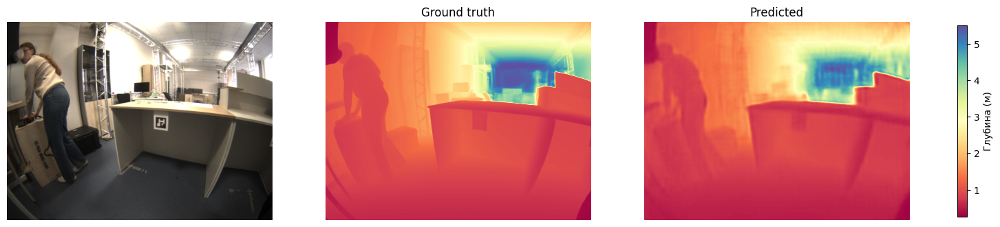

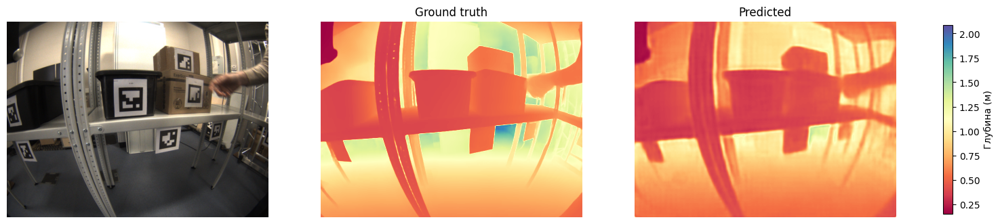

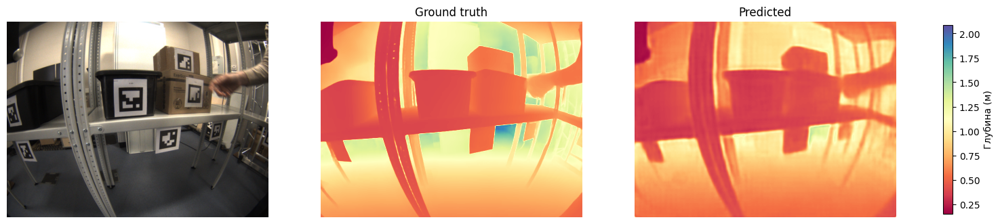

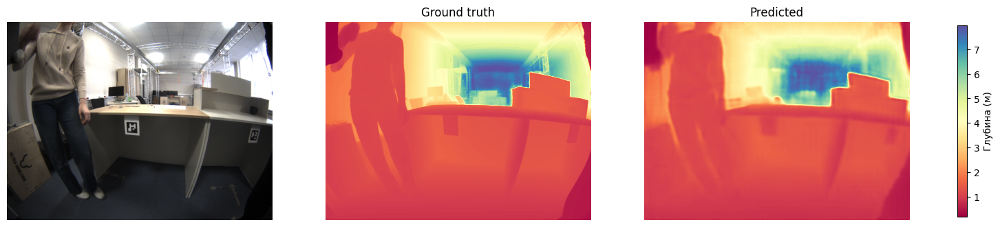

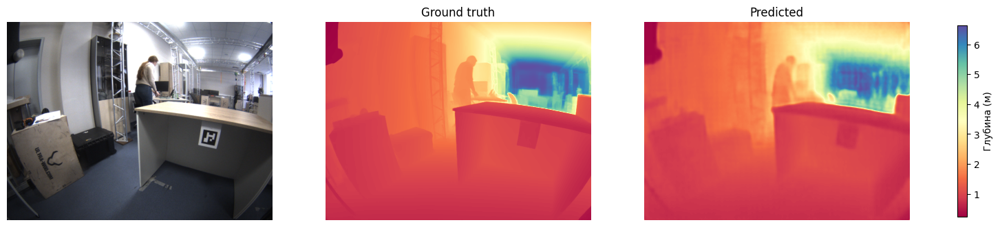

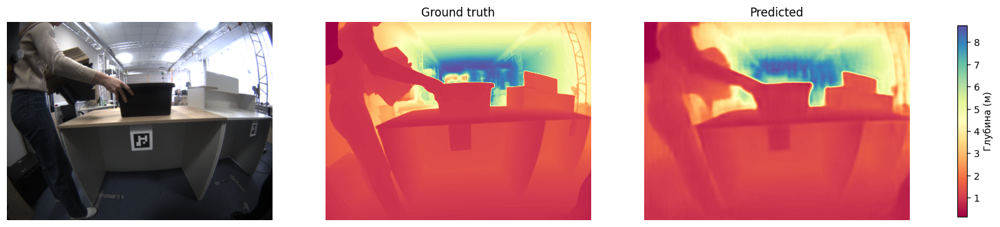

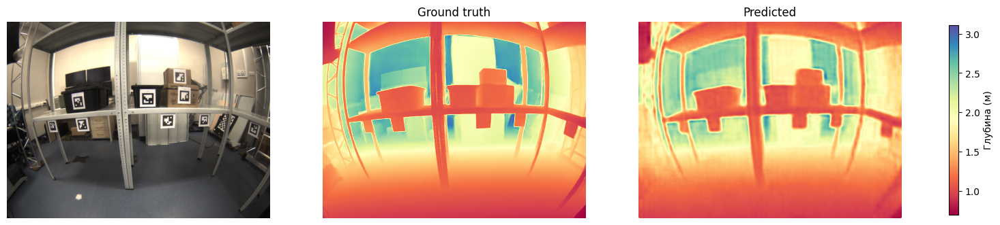

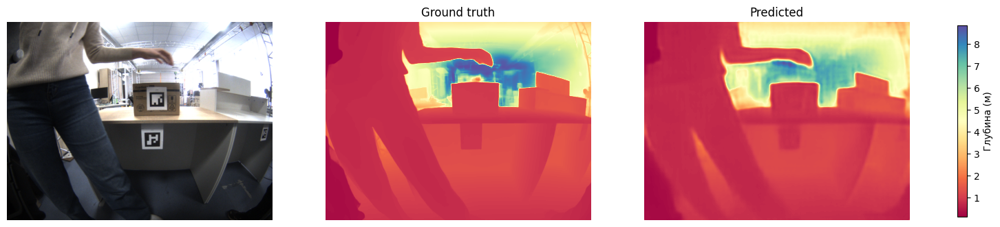

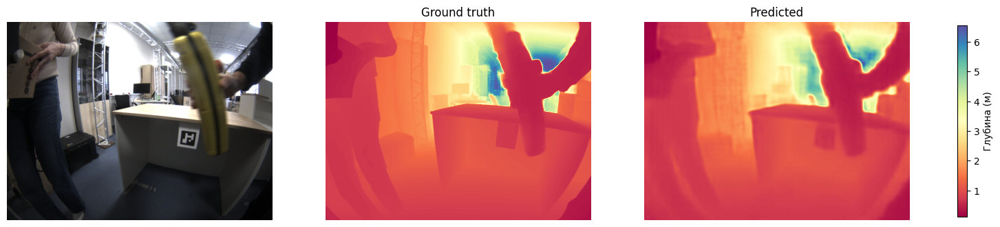

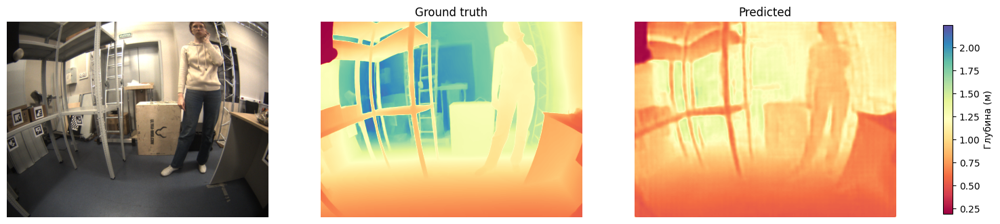

In [39]:
data_dir = '/kaggle/input/fisheye-data-w-depth-maps/fisheye_w_depth_maps'
for subdir in np.random.choice(os.listdir(data_dir), 10):
    fig, ax = plt.subplots(1, 3, figsize=(18, 9))
    img = cv2.imread(os.path.join(data_dir, subdir, 'real_img.png'))
    depth = np.load(os.path.join(data_dir, subdir, 'depth_map.npy'))
    ax[0].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    ax[0].set_axis_off()
    cmap = 'Spectral'
    img_ax = ax[1].imshow(depth, cmap=cmap)
    ax[1].set_axis_off()
    ax[1].set_title('Ground truth')
    ax[2].imshow(model.infer_image(img), cmap=cmap)
    ax[2].set_title('Predicted')
    ax[2].set_axis_off()
    fig.colorbar(
        img_ax, ax=ax, label='Глубина (м)', 
        orientation='vertical', fraction=0.01,
        cmap=cmap
    )
    plt.show()

# Saving

In [40]:
!pip install onnx
!pip install onnxscript

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 678.4/678.4 kB 11.2 MB/s eta 0:00:00 0:00:01


In [41]:
model = DepthAnythingV2Metric(**model_configs['small'], max_depth=20.0)

model_path = os.path.join(MODELS_BASE_PATH, 'depth_anything_v2_metric_hypersim_vits_small.pth')
# only encoder pretrained weights
model.load_state_dict(torch.load(model_path))
onnx_program = torch.onnx.dynamo_export(model, next(iter(train_dataloader))['image'])
onnx_program.save('depth_anything_v2_small.onnx')

/tmp/ipykernel_31/665588014.py:5: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path))
/opt/conda/lib/python3.10/site-packages/onnxscr

Applied 76 of general pattern rewrite rules.


In [42]:
model

DepthAnythingV2(
  (pretrained): DinoVisionTransformer(
    (patch_embed): PatchEmbed(
      (proj): Conv2d(3, 384, kernel_size=(14, 14), stride=(14, 14))
      (norm): Identity()
    )
    (blocks): ModuleList(
      (0-11): 12 x NestedTensorBlock(
        (norm1): LayerNorm((384,), eps=1e-06, elementwise_affine=True)
        (attn): MemEffAttention(
          (qkv): Linear(in_features=384, out_features=1152, bias=True)
          (attn_drop): Dropout(p=0.0, inplace=False)
          (proj): Linear(in_features=384, out_features=384, bias=True)
          (proj_drop): Dropout(p=0.0, inplace=False)
        )
        (ls1): LayerScale()
        (drop_path1): Identity()
        (norm2): LayerNorm((384,), eps=1e-06, elementwise_affine=True)
        (mlp): Mlp(
          (fc1): Linear(in_features=384, out_features=1536, bias=True)
          (act): GELU(approximate='none')
          (fc2): Linear(in_features=1536, out_features=384, bias=True)
          (drop): Dropout(p=0.0, inplace=False)
    